# This cat does not exist
__Суммарное количество баллов: 10__

__Решение отправлять на `ml.course.practice@gmail.com`__

__Тема письма: `[HSE][ML][MS][HW06] <ФИО>`, где вместо `<ФИО>` указаны фамилия и имя__

Цель этого задания - создать котов, которых не существует. В ходе данного задания вы обучите DCGAN и VAE, которые являются одними из первых генеративных моделей. Для этого задания вам наверняка потребуется GPU с CUDA, поэтому рекомендуется использовать Google Colab.

In [1]:
import torch
from torch import nn
from torch.optim import Adam
from torch.nn import functional as F
from torch.utils.data import Dataset, DataLoader
import os 
import cv2
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm
import random
import numpy as np

%matplotlib inline

In [2]:
from google.colab import drive
drive.mount('/content/gdrive')

import os
os.chdir("/content/gdrive/MyDrive/Colab Notebooks/hw06")
!ls

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).
cat_136  hw06_task.ipynb  imgs	old.ipynb


In [3]:
def random_noise(batch_size, channels, side_size):
    return torch.randn(batch_size, channels, side_size, side_size).cuda()

def imagewide_average(x):
    return x.mean(dim=(-1, -2))

In [4]:
def visualise(imgs, rows=2):
    imgs = (imgs.transpose(1, 3) + 1) / 2
    imgs = torch.cat([imgs[i::rows] for i in range(rows)], dim=1)
    cols = len(imgs)
    imgs = (torch.cat(list(imgs), dim=1)).cpu().numpy()[:, :, ::-1]
    plt.figure(figsize=(cols*1.5, rows*1.5))
    plt.imshow(imgs)
    plt.axis('off')
    plt.tight_layout()
    plt.show()

In [5]:
class CatDataset(Dataset):
    def __init__(self, path_to_dataset="cat_136", size=64):
        self.photo_names = os.listdir(path_to_dataset)
        self.path_base = path_to_dataset
        self.size = size
    
    def __getitem__(self, index):
        path = self.path_base + "/" + self.photo_names[index]
        img = cv2.imread(path) # 136 x 136
        crop_rate = 8
        x_crop = random.randint(0, crop_rate)
        y_crop = random.randint(0, crop_rate)
        img = img[x_crop:136 - crop_rate + x_crop, y_crop:136 - crop_rate + y_crop]
        img = cv2.resize(img, (self.size, self.size), interpolation=cv2.INTER_CUBIC)
        return 2 * torch.tensor(img).float().transpose(0, 2) / 255. - 1
    
    def __len__(self):
        return len(self.photo_names)

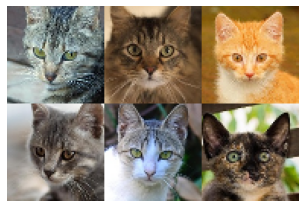

In [6]:
dataset = CatDataset()
visualise(torch.cat([dataset[i].unsqueeze(0) for i in [3, 15, 182, 592, 394, 2941]], dim=0))

### Задание 1 (2 балла)
Для начала реализуем генератор для нашего DCGAN. Предлагается использовать следующую архитектуру:

![](imgs/DCGAN.png)

Для ее реализации вам потребуются модули `nn.BatchNorm2d`, `nn.Conv2d`, `nn.ConvTranspose2D`, `nn.ReLU`, а также функция `F.interpolate`.

#### Методы
* `__init__` - принимает на вход `start_size`, `latent_channels`, `start_channels` и `upsamplings`. Первые два аргумента отвечают за размер случайного шума, из которого в последствии будет сгенерирована картинка. `start_channels` отвечает за то, сколько каналов должно быть в картинке перед тем, как к ней будут применены upsampling блоки. `upsamplings` - это количество upsampling блоков, которые должны быть применены к картинке. В каждом таком блоке количество каналов уменьшается в два раза.


* `forward` - принимает на вход `batch_size`, генерирует `batch_size` картинок из случайного шума.

In [7]:
class Generator(nn.Module):
    def __init__(self, start_size=2, latent_channels=32, start_channels=1024, upsamplings=6):
        super().__init__()
        self.start_size = start_size
        self.latent_channels = latent_channels
        self.start_channels = start_channels
        self.upsamplings = upsamplings
        
        deconv = [None] * upsamplings
        ch = start_channels
        for i in range(upsamplings):
            deconv[i] = nn.ConvTranspose2d(in_channels=ch, out_channels=ch//2, kernel_size=4, stride=2, padding=1)
            ch //=2
        self.deconv = nn.ModuleList(deconv)
        
        norm = [None] * upsamplings
        ch = start_channels
        for i in range(upsamplings):
            ch //=2
            norm[i] = nn.BatchNorm2d(num_features=ch)
        self.norm = nn.ModuleList(norm)
        
        self.relu = nn.ReLU()
        
        self.conv1 = nn.Conv2d(in_channels=latent_channels, out_channels=start_channels, kernel_size=1)
        self.conv2 = nn.Conv2d(in_channels=ch, out_channels=3, kernel_size=1)
        
        
    def forward(self, batch_size: int):
        data = torch.randn(batch_size, self.latent_channels, self.start_size, self.start_size).cuda()
        
        data = self.conv1(data)
        
        for i in range(self.upsamplings):
            data = self.deconv[i](data)
            data = self.norm[i](data)
            data = self.relu(data)
        
        data = self.conv2(data)
        
        data = torch.tanh(data)
        
        return data # torch.Tensor batch_size x 3 x (start_size * 2**upsamplings) x (start_size * 2**upsamplings)

### Задание 2 (2 балла)
Теперь реализуем дискриминатор для нашего DCGAN. Предлагается использовать следующую архитектуру:

![](imgs/Disc_DCGAN.png)

Для ее реализации вам потребуются модули `nn.BatchNorm2d`, `nn.Conv2d`, `nn.ReLU` и `nn.Sigmoid`.

#### Методы
* `__init__` - принимает на вход `start_channels` и `downsamplings`. `start_channels` определяет количество каналов, которые должны быть в изображении перед применением downsampling блоков.


* `forward` - принимает на вход `x` - тензор с картинками. Возвращает вектор с размерностью `batch_size`.

In [8]:
class Discriminator(nn.Module):
    def __init__(self, downsamplings=6, start_channels=8):
        super().__init__()
        self.downsamplings = downsamplings
        self.start_channels = start_channels
        
        conv = [None] * downsamplings
        ch = start_channels 
        for i in range(downsamplings):
            conv[i] = nn.Conv2d(in_channels=ch, out_channels=ch*2, kernel_size=3, stride=2, padding=1)
            ch *=2
        self.conv = nn.ModuleList(conv)
        
        norm = [None] * downsamplings
        ch = start_channels 
        for i in range(downsamplings):
            ch *=2
            norm[i] = nn.BatchNorm2d(num_features=ch)
        self.norm = nn.ModuleList(norm)
    
        self.relu = nn.ReLU()
        
        self.conv1 = nn.Conv2d(in_channels=3, out_channels=start_channels, kernel_size=1)
        self.sigmoid = nn.Sigmoid()
        
        self.linear_initialized = False
        
    def init_linear(self, in_features):
        self.linear = nn.Linear(in_features=in_features, out_features=1).cuda()
        self.linear_initialized = True
    
    def forward(self, x):
        data = self.conv1(x)
        
        for i in range(self.downsamplings):
            data = self.conv[i](data)
            data = self.norm[i](data)
            data = self.relu(data)
        
        data = data.flatten(start_dim=1)
        
        # костыль для прокидывания параметра in_features в линейный слой
        if not self.linear_initialized:
            self.init_linear(data.shape[1])
        
        data = self.linear(data)
        
        data = self.sigmoid(data)
        
        return data # torch.Tensor batch_size x 1

In [9]:
def train_gan():
    generator = Generator()
    discriminator = Discriminator()
    epochs = 120
    visualise_every = 15
    batch_size = 128
    generator.cuda()
    discriminator.cuda()

    gen_optim = Adam(generator.parameters(), lr=1e-4, betas=(0.5, 0.999))
    disc_optim = Adam(discriminator.parameters(), lr=1e-4, betas=(0.5, 0.999))

    dataset = CatDataset(size=128)

    for ep in range(epochs):
        dataloader = DataLoader(dataset, shuffle=True, batch_size=batch_size)
        total_batches = 0
        gen_loss_avg = 0
        disc_loss_avg = 0

        for i, batch in tqdm(enumerate(dataloader), total=(len(dataset) + batch_size) // batch_size):
            if len(batch) < batch_size:
                continue
            total_batches += 1
            # Positive update
            batch = batch.cuda()
            pred = discriminator(batch)
            loss = F.binary_cross_entropy(pred, torch.ones_like(pred))
            disc_optim.zero_grad()
            loss.backward()
            disc_optim.step()
            disc_loss_avg += loss.item()

            # Negative update
            batch = generator(batch_size).detach()
            pred = discriminator(batch)
            loss = F.binary_cross_entropy(pred, torch.zeros_like(pred))
            disc_optim.zero_grad()
            loss.backward()
            disc_optim.step()
            disc_loss_avg += loss.item()

            # Generator update
            batch = generator(batch_size)
            pred = discriminator(batch)
            loss = F.binary_cross_entropy(pred, torch.ones_like(pred))
            gen_optim.zero_grad()
            loss.backward()
            gen_optim.step()
            gen_loss_avg += loss.item()
            
            if i < 5 and (ep + 1) % visualise_every == 0:
                with torch.no_grad():
                    visualise(generator(6), rows=2)

        print(f"Epoch {ep+1} | Discriminator loss: {disc_loss_avg / total_batches} | Generator loss: {gen_loss_avg / total_batches}")

  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 1 | Discriminator loss: 0.9020416975021363 | Generator loss: 2.3027278587222098


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 2 | Discriminator loss: 0.24627903683576732 | Generator loss: 4.098358464241028


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 3 | Discriminator loss: 0.10355224311351777 | Generator loss: 4.330901390314102


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 4 | Discriminator loss: 0.09834051828365772 | Generator loss: 4.598157149553299


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 5 | Discriminator loss: 0.3846220494713634 | Generator loss: 3.4907423317432404


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 6 | Discriminator loss: 0.48356530303135514 | Generator loss: 3.5599169701337816


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 7 | Discriminator loss: 0.6150113582611084 | Generator loss: 3.2490695834159853


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 8 | Discriminator loss: 0.6959877673536539 | Generator loss: 2.952254664897919


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 9 | Discriminator loss: 0.789482518285513 | Generator loss: 2.6780440866947175


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 10 | Discriminator loss: 0.8560037184506655 | Generator loss: 2.43528408408165


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 11 | Discriminator loss: 0.7963508794084191 | Generator loss: 2.537111234664917


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 12 | Discriminator loss: 0.8684022776782513 | Generator loss: 2.4929883658885954


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 13 | Discriminator loss: 1.0396248333156108 | Generator loss: 2.040635746717453


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 14 | Discriminator loss: 1.1009627364575862 | Generator loss: 1.9194803535938263


  0%|          | 0/41 [00:00<?, ?it/s]

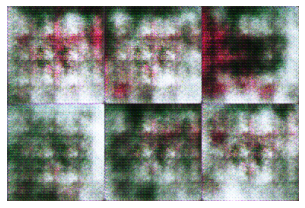

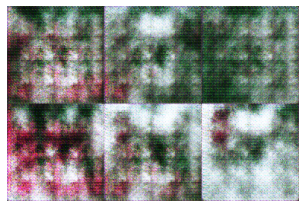

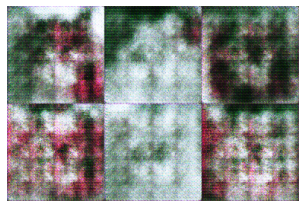

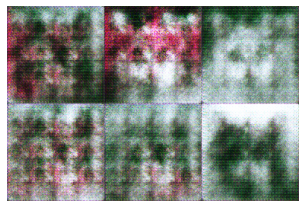

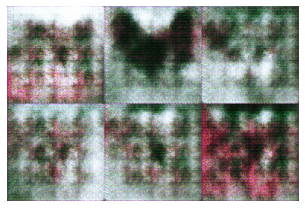

Epoch 15 | Discriminator loss: 1.081775338947773 | Generator loss: 1.7633577823638915


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 16 | Discriminator loss: 1.0712977938354016 | Generator loss: 1.7225955992937088


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 17 | Discriminator loss: 1.106340929865837 | Generator loss: 1.6501434922218323


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 18 | Discriminator loss: 1.107423797994852 | Generator loss: 1.5579528659582138


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 19 | Discriminator loss: 1.1244465306401252 | Generator loss: 1.5527239620685578


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 20 | Discriminator loss: 1.0956818848848342 | Generator loss: 1.5622781038284301


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 21 | Discriminator loss: 1.107811903208494 | Generator loss: 1.5126219123601914


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 22 | Discriminator loss: 1.0961121931672095 | Generator loss: 1.5904878735542298


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 23 | Discriminator loss: 1.0855580799281597 | Generator loss: 1.603985670208931


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 24 | Discriminator loss: 1.0925677493214607 | Generator loss: 1.6485756576061248


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 25 | Discriminator loss: 1.0545603320002557 | Generator loss: 1.6349282532930374


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 26 | Discriminator loss: 1.04390020146966 | Generator loss: 1.6735993832349778


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 27 | Discriminator loss: 1.042848278582096 | Generator loss: 1.6299513131380081


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 28 | Discriminator loss: 1.0789896115660667 | Generator loss: 1.5611419558525086


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 29 | Discriminator loss: 1.1414091914892197 | Generator loss: 1.5577405154705048


  0%|          | 0/41 [00:00<?, ?it/s]

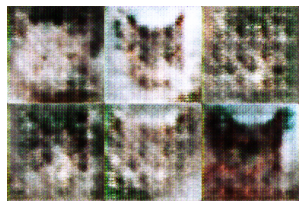

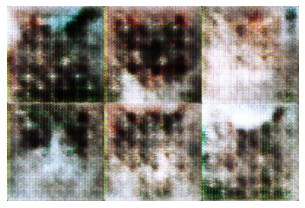

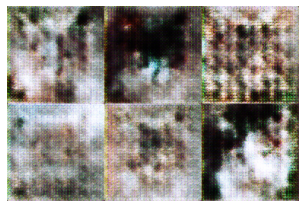

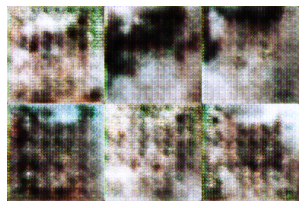

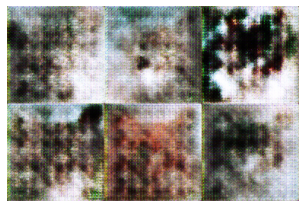

Epoch 30 | Discriminator loss: 1.0854987755417824 | Generator loss: 1.5307857930660247


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 31 | Discriminator loss: 1.099906225502491 | Generator loss: 1.5247256875038147


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 32 | Discriminator loss: 1.1007750414311885 | Generator loss: 1.5981052935123443


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 33 | Discriminator loss: 1.1021252498030663 | Generator loss: 1.5633174359798432


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 34 | Discriminator loss: 1.1234292104840278 | Generator loss: 1.4365572661161423


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 35 | Discriminator loss: 1.1549882583320141 | Generator loss: 1.4691356778144837


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 36 | Discriminator loss: 1.1259541802108288 | Generator loss: 1.4034515798091889


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 37 | Discriminator loss: 1.1684755630791188 | Generator loss: 1.332320785522461


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 38 | Discriminator loss: 1.1406326912343503 | Generator loss: 1.34478257894516


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 39 | Discriminator loss: 1.1626970864832402 | Generator loss: 1.3325014263391495


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 40 | Discriminator loss: 1.1300858460366725 | Generator loss: 1.3445088356733321


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 41 | Discriminator loss: 1.172705090045929 | Generator loss: 1.2897427201271057


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 42 | Discriminator loss: 1.1388324625790118 | Generator loss: 1.2593155384063721


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 43 | Discriminator loss: 1.1660876028239726 | Generator loss: 1.3182469487190247


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 44 | Discriminator loss: 1.1403321787714957 | Generator loss: 1.240256479382515


  0%|          | 0/41 [00:00<?, ?it/s]

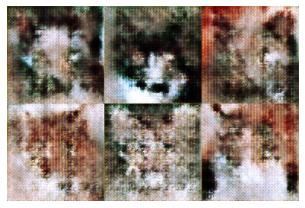

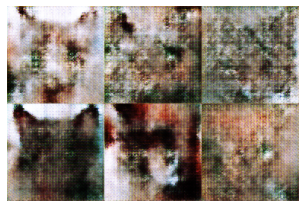

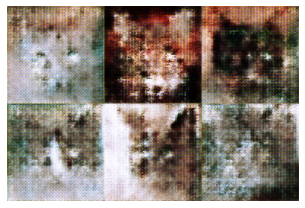

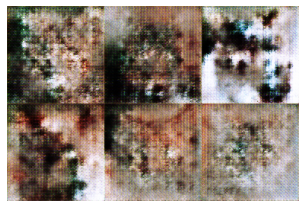

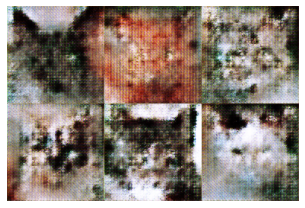

Epoch 45 | Discriminator loss: 1.1570164009928703 | Generator loss: 1.286071240901947


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 46 | Discriminator loss: 1.152311958372593 | Generator loss: 1.2517566844820975


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 47 | Discriminator loss: 1.1536878913640976 | Generator loss: 1.2387784093618393


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 48 | Discriminator loss: 1.1768722645938396 | Generator loss: 1.234512633085251


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 49 | Discriminator loss: 1.1486079446971416 | Generator loss: 1.2430927991867065


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 50 | Discriminator loss: 1.1550357453525066 | Generator loss: 1.2431428492069245


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 51 | Discriminator loss: 1.137608914077282 | Generator loss: 1.2366483896970748


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 52 | Discriminator loss: 1.1116702161729335 | Generator loss: 1.3012788534164428


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 53 | Discriminator loss: 1.1536464728415012 | Generator loss: 1.220206931233406


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 54 | Discriminator loss: 1.1282468743622303 | Generator loss: 1.2662740737199782


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 55 | Discriminator loss: 1.1271864861249923 | Generator loss: 1.2743150293827057


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 56 | Discriminator loss: 1.1239929504692554 | Generator loss: 1.2287034690380096


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 57 | Discriminator loss: 1.1344814211130143 | Generator loss: 1.2193229883909225


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 58 | Discriminator loss: 1.1562146678566934 | Generator loss: 1.2257592618465423


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 59 | Discriminator loss: 1.1222515836358071 | Generator loss: 1.2462337091565132


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 89 | Discriminator loss: 1.0205530114471912 | Generator loss: 1.3451713383197785


  0%|          | 0/41 [00:00<?, ?it/s]

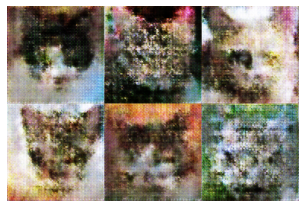

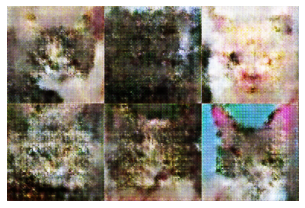

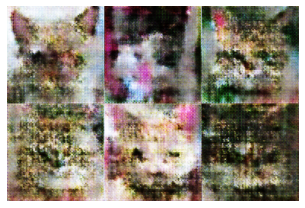

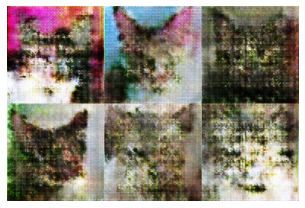

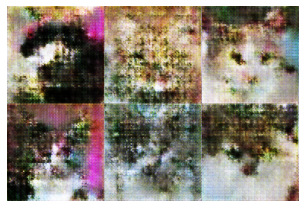

Epoch 90 | Discriminator loss: 1.0189829871058464 | Generator loss: 1.324520891904831


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 91 | Discriminator loss: 1.019386450201273 | Generator loss: 1.3455481767654418


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 92 | Discriminator loss: 1.0249113507568837 | Generator loss: 1.317417362332344


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 93 | Discriminator loss: 1.0211664080619811 | Generator loss: 1.310459840297699


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 94 | Discriminator loss: 1.00367214679718 | Generator loss: 1.3798965573310853


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 95 | Discriminator loss: 1.012399536371231 | Generator loss: 1.3270148992538453


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 96 | Discriminator loss: 1.0017667658627034 | Generator loss: 1.3009007543325424


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 97 | Discriminator loss: 0.9886546283960342 | Generator loss: 1.3467222094535827


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 98 | Discriminator loss: 0.9858837760984898 | Generator loss: 1.390840858221054


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 99 | Discriminator loss: 0.9431552700698376 | Generator loss: 1.4403666228055954


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 100 | Discriminator loss: 0.974271135777235 | Generator loss: 1.3687434107065202


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 101 | Discriminator loss: 0.9564862959086895 | Generator loss: 1.3594891250133514


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 102 | Discriminator loss: 0.9939012423157692 | Generator loss: 1.393386924266815


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 103 | Discriminator loss: 0.9572300259023905 | Generator loss: 1.39633107483387


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 104 | Discriminator loss: 0.9541353099048138 | Generator loss: 1.4214610129594802


  0%|          | 0/41 [00:00<?, ?it/s]

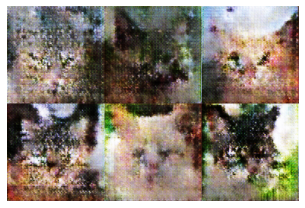

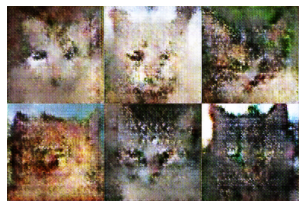

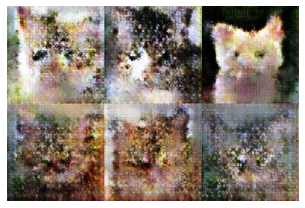

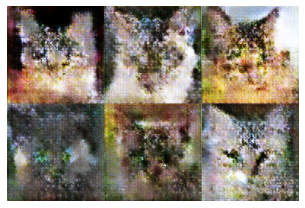

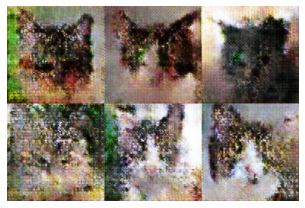

In [10]:
train_gan()

### Задание 3 (5 баллов)
Теперь посмотрим на другую модель: Variational Autoencoder. В отличии от GAN, в котором генератор пытается обмануть дискриминатор, а дискриминатор старается не быть обманутым, VAE решает задачу реконструкции элемента множества X с применением регуляризации в латентном пространстве. 

Полностью архитектура выглядит так:
![](imgs/VAE.png)

Из нее можно выделить две части: Encoder (по изображению возвращает mu и sigma) и Decoder (по случайному шуму восстанавливает изображение). На высоком уровне VAE можно представить так:

![](imgs/VAE_highlevel.png)

В данном задании вам необходимо реализовать полную архитектуру VAE.

#### Методы
* `__init__` - принимает на вход `img_size`, `downsamplings`, `latent_size`, `linear_hidden_size`, `down_channels` и `up_channels`. `img_size` - размер стороны входного изображения. `downsamplings` - количество downsampling (и upsampling) блоков. `latent_size` - размер латентного пространства, в котором в который будет закодирована картинка. `linear_hidden_size` количество нейронов на скрытом слое полносвязной сети в конце encoder'а. Для полносвязной сети decoder'а это число стоит умножить на 2. `down_channels` - количество каналов, в которое будет преобразовано трехцветное изображение перед применением `downsampling` блоков. `up_channels` - количество каналов, которое должно получиться после применения всех upsampling блоков.

* `forward` - принимает на вход `x`. Считает распределение $N(\mu, \sigma^2)$ и вектор $z \sim N(\mu, \sigma^2)$. Возвращает $x'$ - восстановленную из вектора $z$ картинку и $D_{KL}(N(\mu, \sigma^2), N(0, 1)) = 0.5 \cdot (\sigma^2 + \mu^2 - \log \sigma^2 - 1)$.

* `encode` - принимает на вход `x`. Возвращает вектор из распределения $N(\mu, \sigma^2)$.

* `decode` - принимает на вход `z`. Возвращает восстановленную по вектору картинку.


#### Если хочется улучшить качество
https://arxiv.org/pdf/1906.00446.pdf

In [ ]:
class VAE(nn.Module):
    def __init__(self, img_size=128, downsamplings=5, latent_size=512, linear_hidden_size=1024, down_channels=8, up_channels=16):
        super().__init__()
        
        self.img_size = img_size
        self.downsamplings = downsamplings
        self.latent_size = latent_size
        self.linear_hidden_size = linear_hidden_size
        self.down_channels = down_channels
        self.up_channels = up_channels
        
        # for encoder -----------------------------------------------------------------------------------------------------
        modules = []
        modules.append(nn.Conv2d(in_channels=3, out_channels=down_channels, kernel_size=1))
        
        for i in range(downsamplings):
            modules.append(nn.Conv2d(down_channels * 2**i, down_channels * 2**(i+1), kernel_size=3, stride=2, padding=1))
            modules.append(nn.BatchNorm2d(num_features=down_channels * 2**(i+1)))
            modules.append(nn.ReLU())
        
        modules.append(nn.Conv2d(in_channels=down_channels * 2**downsamplings, out_channels = 2*latent_size, kernel_size=1))
        
        self.conv_seq_encod = nn.Sequential(*modules)
        
        self.linear1_encod = nn.Linear(in_features=2*latent_size*(img_size//2**downsamplings)**2, out_features=linear_hidden_size)
        self.linear2_encod = nn.Linear(in_features=linear_hidden_size, out_features=2*latent_size)
        
        
        # for decoder -----------------------------------------------------------------------------------------------------
        upsamplings = downsamplings
        self.upsamplings = upsamplings
        
        self.linear1_decod = nn.Linear(latent_size, linear_hidden_size*2)
        self.linear2_decod = nn.Linear(linear_hidden_size*2, up_channels * 2**upsamplings * (img_size//2**upsamplings)**2)
        
        modules = []
        for i in range(upsamplings):
            modules.append(nn.ConvTranspose2d(up_channels * 2**(upsamplings-i), up_channels * 2**(upsamplings-i-1), kernel_size=4, stride=2, padding=1))
            modules.append(nn.BatchNorm2d(num_features=up_channels * 2**(upsamplings-i-1)))
            modules.append(nn.ReLU())
        
        modules.append(nn.Conv2d(in_channels=up_channels, out_channels = 3, kernel_size=1))
        
        self.conv_seq_decod = nn.Sequential(*modules)
        
    def forward(self, x):
        x = self.conv_seq_encod(x)
        x = x.flatten(start_dim=1)
        x = self.linear1_encod(x)
        x = self.linear2_encod(x)
        
        mu = x[:,:x.shape[1]//2]
        sigma = torch.exp(x[:,x.shape[1]//2:])
        
        z = mu + torch.randn(x.shape[0], self.latent_size).cuda() * sigma

        z = self.linear1_decod(z)
        z = self.linear2_decod(z)
        unflatten = nn.Unflatten(1, (self.up_channels * 2**self.upsamplings, self.img_size//2**self.upsamplings, self.img_size//2**self.upsamplings))
        z = unflatten(z)
        z = self.conv_seq_decod(z)
        x_pred = torch.tanh(z)
        
        kld = 0.5 * (sigma**2 + mu**2 - torch.log(sigma**2) - 1)
        
        return x_pred, kld
    
    def encode(self, x):
        x = self.conv_seq_encod(x)
        x = x.flatten(start_dim=1)
        x = self.linear1_encod(x)
        x = self.linear2_encod(x)
        
        mu = x[:,:x.shape[1]//2]
        sigma = torch.exp(x[:,x.shape[1]//2:])
        
        z = mu + torch.randn(x.shape[0], self.latent_size).cuda() * sigma
        z = z.cuda()
        
        return z
    
    def decode(self, z):
        z = self.linear1_decod(z)
        z = self.linear2_decod(z)
        unflatten = nn.Unflatten(1, (self.up_channels * 2**self.upsamplings, self.img_size//2**self.upsamplings, self.img_size//2**self.upsamplings))
        z = unflatten(z)
        z = self.conv_seq_decod(z)
        x_pred = torch.tanh(z)
        
        return x_pred

In [ ]:
def train_vae():
    vae = VAE()
    vae.cuda()

    epochs = 201
    batch_size = 128
    vae_optim = Adam(vae.parameters(), lr=1e-4)

    dataset = CatDataset(size=128)

    test_imgs_1 = torch.cat([dataset[i].unsqueeze(0) for i in (0, 34, 76, 1509)])
    test_imgs_2 = torch.cat([dataset[i].unsqueeze(0) for i in (734, 123, 512, 3634)])

    for ep in range(epochs):
        dataloader = DataLoader(dataset, shuffle=True, batch_size=batch_size)
        total_batches = 0
        rec_loss_avg = 0
        kld_loss_avg = 0

        if ep % 10 == 0:
            with torch.no_grad():
                z_1 = vae.encode(test_imgs_1.cuda())
                z_2 = vae.encode(test_imgs_2.cuda())
                x_int = []
                for i in range(9):
                    z = (i * z_1 + (8 - i) * z_2) / 8
                    x_int.append(vae.decode(z))
                x_int = torch.cat(x_int)
                visualise(x_int, rows=len(test_imgs_1))
                z_rand = torch.randn_like(z_1)
                x_int = vae.decode(z_rand)
                visualise(x_int, rows=len(test_imgs_1)//2)

        for i, batch in tqdm(enumerate(dataloader), total=(len(dataset) + batch_size) // batch_size):
            if len(batch) < batch_size:
                continue
            total_batches += 1
            x = batch.cuda()
            x_rec, kld = vae(x)
            img_elems = float(np.prod(list(batch.size())))
            kld_loss = kld.sum() / batch_size
            rec_loss = ((x_rec - x)**2).sum() / batch_size
            loss = rec_loss + 0.1 * kld_loss # https://openreview.net/forum?id=Sy2fzU9gl
            vae_optim.zero_grad()
            loss.backward()
            vae_optim.step()
            kld_loss_avg += kld_loss.item()
            rec_loss_avg += rec_loss.item()

        print(f"Epoch {ep+1} | Reconstruction loss: {rec_loss_avg / total_batches} | KLD loss: {kld_loss_avg / total_batches}")


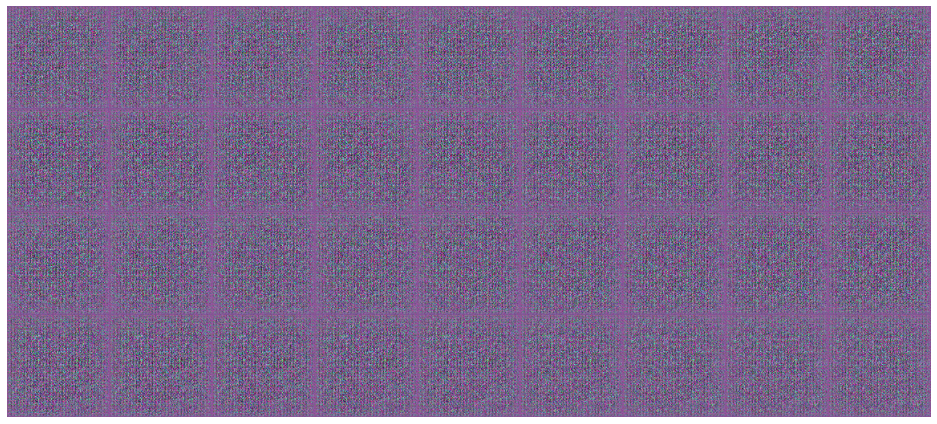

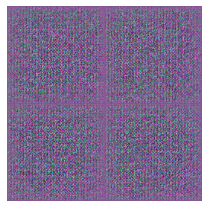

  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 1 | Reconstruction loss: 14553.814038085937 | KLD loss: 111426.54460639953


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 2 | Reconstruction loss: 11858.8513671875 | KLD loss: 298.4514415740967


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 3 | Reconstruction loss: 9641.065478515626 | KLD loss: 490.58287887573243


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 4 | Reconstruction loss: 8045.608227539063 | KLD loss: 799.9626235961914


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 5 | Reconstruction loss: 7205.362133789063 | KLD loss: 967.7424453735351


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 6 | Reconstruction loss: 6613.192846679687 | KLD loss: 1088.1684661865233


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 7 | Reconstruction loss: 6156.392724609375 | KLD loss: 1192.9315521240235


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 8 | Reconstruction loss: 5839.878430175781 | KLD loss: 1267.8465606689454


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 9 | Reconstruction loss: 5591.072180175781 | KLD loss: 1314.1872497558593


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 10 | Reconstruction loss: 5362.279345703125 | KLD loss: 1359.1921783447265


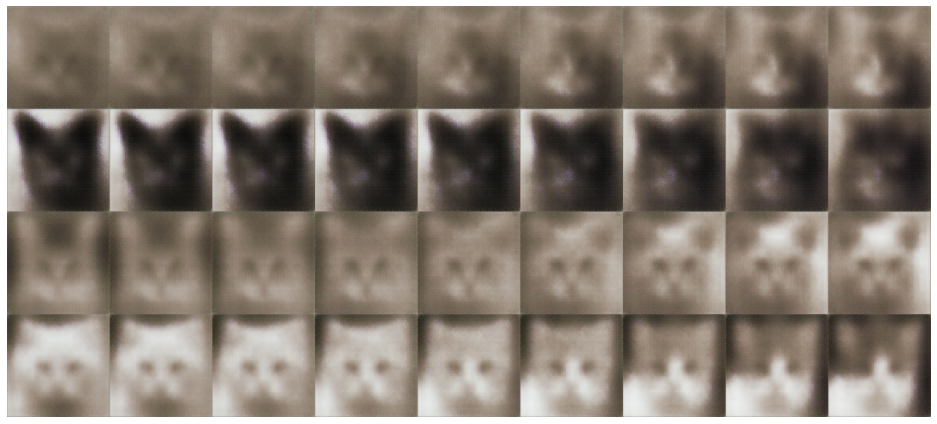

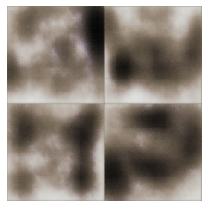

  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 11 | Reconstruction loss: 5186.813159179687 | KLD loss: 1385.3960998535156


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 12 | Reconstruction loss: 5043.011999511718 | KLD loss: 1408.0106262207032


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 13 | Reconstruction loss: 4932.760070800781 | KLD loss: 1428.4396575927735


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 14 | Reconstruction loss: 4783.772448730469 | KLD loss: 1447.2989013671875


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 15 | Reconstruction loss: 4639.024865722657 | KLD loss: 1461.2725982666016


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 16 | Reconstruction loss: 4487.189862060547 | KLD loss: 1482.8598907470703


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 17 | Reconstruction loss: 4351.432623291015 | KLD loss: 1494.1009216308594


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 18 | Reconstruction loss: 4248.328216552734 | KLD loss: 1493.0119018554688


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 19 | Reconstruction loss: 4145.204602050781 | KLD loss: 1505.017630004883


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 20 | Reconstruction loss: 4061.5355224609375 | KLD loss: 1508.4049713134766


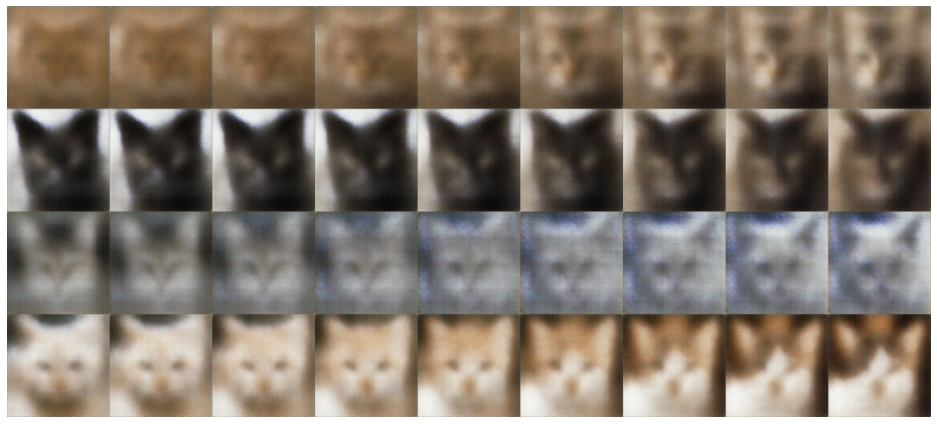

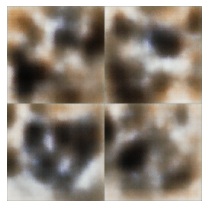

  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 21 | Reconstruction loss: 3993.8597412109375 | KLD loss: 1508.7591033935546


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 22 | Reconstruction loss: 3915.0225036621096 | KLD loss: 1509.606851196289


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 23 | Reconstruction loss: 3861.296514892578 | KLD loss: 1512.486245727539


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 24 | Reconstruction loss: 3795.109167480469 | KLD loss: 1517.478060913086


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 25 | Reconstruction loss: 3735.7397888183596 | KLD loss: 1519.6408569335938


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 26 | Reconstruction loss: 3691.6908935546876 | KLD loss: 1521.6704650878905


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 27 | Reconstruction loss: 3637.733740234375 | KLD loss: 1521.8990570068358


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 28 | Reconstruction loss: 3592.7013916015626 | KLD loss: 1512.6174255371093


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 29 | Reconstruction loss: 3547.3998901367186 | KLD loss: 1513.020425415039


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 30 | Reconstruction loss: 3510.156329345703 | KLD loss: 1517.8773559570313


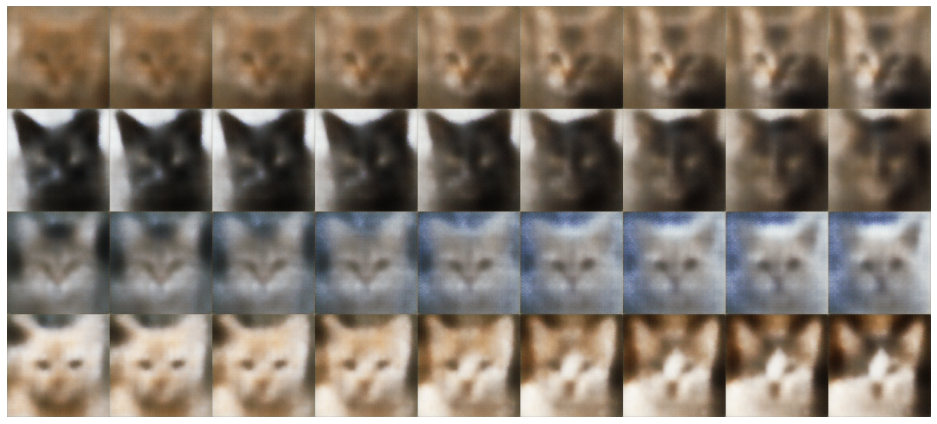

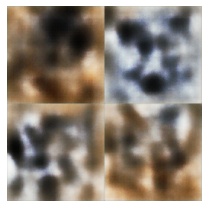

  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 31 | Reconstruction loss: 3471.8971557617188 | KLD loss: 1516.9556396484375


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 32 | Reconstruction loss: 3436.7338989257814 | KLD loss: 1517.5396697998046


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 33 | Reconstruction loss: 3392.432080078125 | KLD loss: 1516.0496795654296


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 34 | Reconstruction loss: 3352.0236755371093 | KLD loss: 1513.2818664550782


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 35 | Reconstruction loss: 3315.3149536132814 | KLD loss: 1515.5831390380858


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 36 | Reconstruction loss: 3305.2704345703123 | KLD loss: 1516.9348083496093


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 37 | Reconstruction loss: 3261.0166198730467 | KLD loss: 1512.3984069824219


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 38 | Reconstruction loss: 3240.470330810547 | KLD loss: 1508.9249542236328


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 39 | Reconstruction loss: 3218.6574768066407 | KLD loss: 1509.1081909179688


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 40 | Reconstruction loss: 3169.9711730957033 | KLD loss: 1505.3690979003907


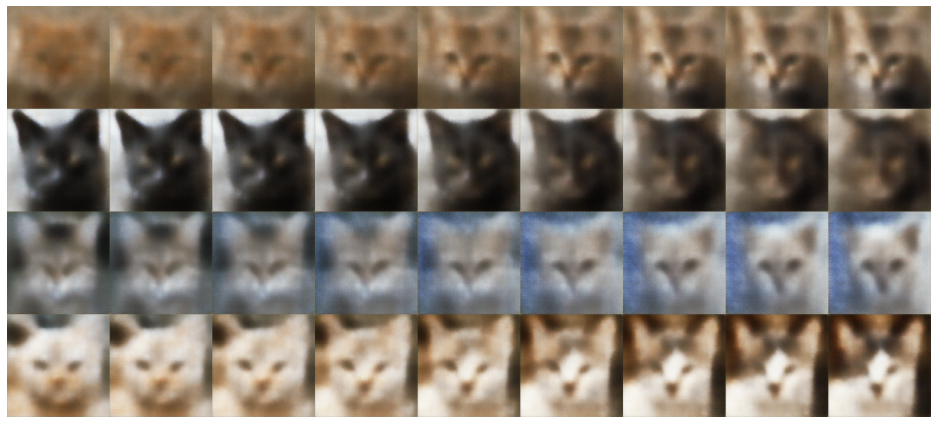

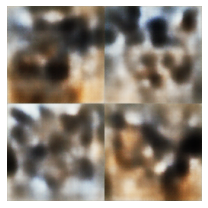

  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 41 | Reconstruction loss: 3152.235943603516 | KLD loss: 1507.2259704589844


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 42 | Reconstruction loss: 3133.9052917480467 | KLD loss: 1503.5184387207032


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 43 | Reconstruction loss: 3106.355780029297 | KLD loss: 1499.5525970458984


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 44 | Reconstruction loss: 3078.0378601074217 | KLD loss: 1498.2807983398438


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 45 | Reconstruction loss: 3047.150732421875 | KLD loss: 1496.6361053466796


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 46 | Reconstruction loss: 3027.332244873047 | KLD loss: 1497.5372985839845


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 47 | Reconstruction loss: 3008.0702575683595 | KLD loss: 1498.306640625


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 48 | Reconstruction loss: 2991.2584594726563 | KLD loss: 1493.2186065673827


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 49 | Reconstruction loss: 2954.471759033203 | KLD loss: 1497.7466674804687


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 50 | Reconstruction loss: 2959.9026611328127 | KLD loss: 1493.9228820800781


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 51 | Reconstruction loss: 2930.518835449219 | KLD loss: 1491.3874603271483


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 52 | Reconstruction loss: 2909.034796142578 | KLD loss: 1497.1267944335937


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 53 | Reconstruction loss: 2900.875146484375 | KLD loss: 1491.4378784179687


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 54 | Reconstruction loss: 2873.5493896484377 | KLD loss: 1487.5960998535156


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 55 | Reconstruction loss: 2863.117810058594 | KLD loss: 1489.2358459472657


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 56 | Reconstruction loss: 2837.178680419922 | KLD loss: 1489.6075805664063


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 57 | Reconstruction loss: 2822.49765625 | KLD loss: 1488.6348541259765


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 58 | Reconstruction loss: 2801.812707519531 | KLD loss: 1481.9529510498046


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 59 | Reconstruction loss: 2792.9103881835936 | KLD loss: 1484.0652862548827


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 60 | Reconstruction loss: 2779.612969970703 | KLD loss: 1483.7216827392579


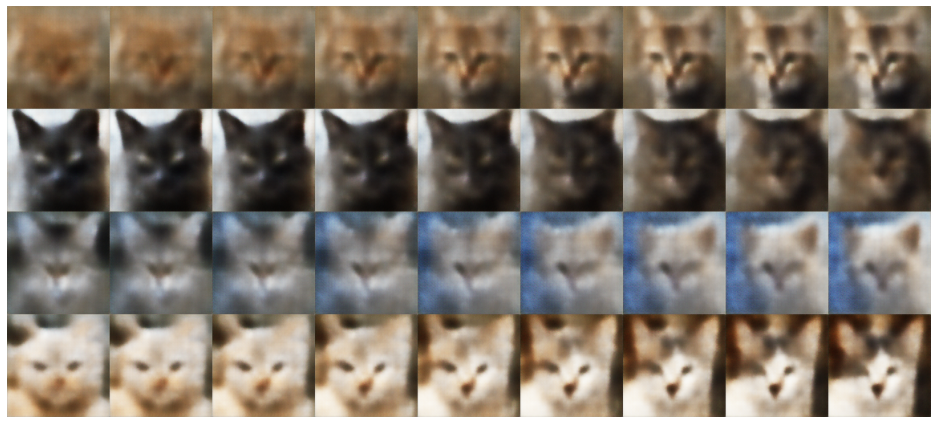

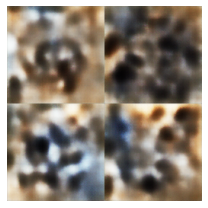

  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 61 | Reconstruction loss: 2765.155310058594 | KLD loss: 1486.6957977294921


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 62 | Reconstruction loss: 2739.4782104492188 | KLD loss: 1481.064370727539


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 63 | Reconstruction loss: 2726.2402954101562 | KLD loss: 1478.7569732666016


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 64 | Reconstruction loss: 2709.9897521972657 | KLD loss: 1480.358364868164


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 65 | Reconstruction loss: 2695.6282958984375 | KLD loss: 1481.6987701416015


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 66 | Reconstruction loss: 2691.8300537109376 | KLD loss: 1477.6929656982422


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 67 | Reconstruction loss: 2668.207629394531 | KLD loss: 1479.6193115234375


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 68 | Reconstruction loss: 2666.030163574219 | KLD loss: 1479.5865478515625


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 69 | Reconstruction loss: 2648.958837890625 | KLD loss: 1473.4888793945313


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 70 | Reconstruction loss: 2637.7794555664063 | KLD loss: 1476.2606262207032


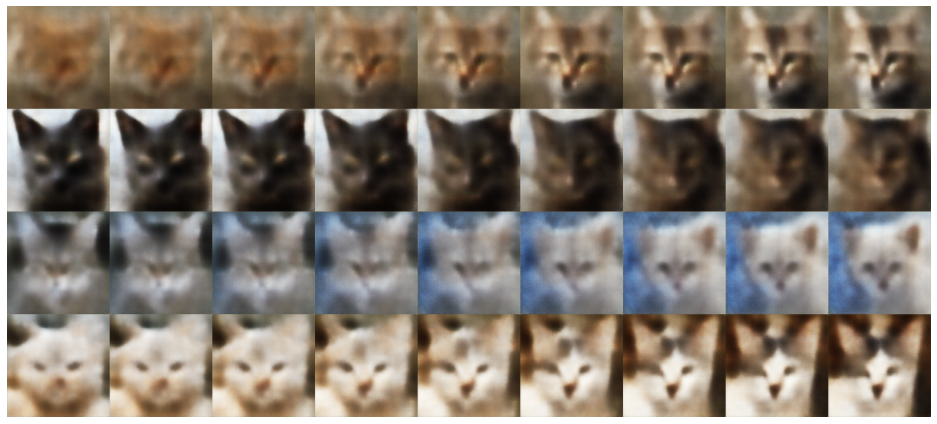

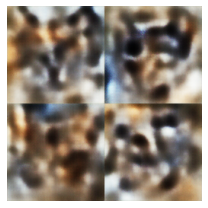

  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 71 | Reconstruction loss: 2628.4946716308596 | KLD loss: 1469.7225769042968


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 72 | Reconstruction loss: 2614.2048156738283 | KLD loss: 1474.9795989990234


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 73 | Reconstruction loss: 2602.8325622558596 | KLD loss: 1472.7252990722657


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 74 | Reconstruction loss: 2583.533935546875 | KLD loss: 1467.8607177734375


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 75 | Reconstruction loss: 2573.434356689453 | KLD loss: 1471.7314239501952


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 76 | Reconstruction loss: 2573.114825439453 | KLD loss: 1469.3733459472655


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 77 | Reconstruction loss: 2560.527972412109 | KLD loss: 1465.631399536133


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 78 | Reconstruction loss: 2546.574151611328 | KLD loss: 1466.4305328369142


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 79 | Reconstruction loss: 2531.2691284179687 | KLD loss: 1462.1666687011718


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 80 | Reconstruction loss: 2528.9751098632814 | KLD loss: 1465.0418823242187


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 81 | Reconstruction loss: 2514.273541259766 | KLD loss: 1459.1713165283204


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 82 | Reconstruction loss: 2522.6095275878906 | KLD loss: 1460.7706085205077


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 83 | Reconstruction loss: 2492.3940185546876 | KLD loss: 1460.6524993896485


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 84 | Reconstruction loss: 2493.505651855469 | KLD loss: 1457.7684783935547


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 85 | Reconstruction loss: 2477.992224121094 | KLD loss: 1455.1777557373048


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 86 | Reconstruction loss: 2463.173065185547 | KLD loss: 1455.7623138427734


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 87 | Reconstruction loss: 2475.6131225585937 | KLD loss: 1454.61474609375


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 88 | Reconstruction loss: 2447.664678955078 | KLD loss: 1451.632534790039


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 89 | Reconstruction loss: 2436.2521545410154 | KLD loss: 1452.4997100830078


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 90 | Reconstruction loss: 2436.3090942382814 | KLD loss: 1454.5434997558593


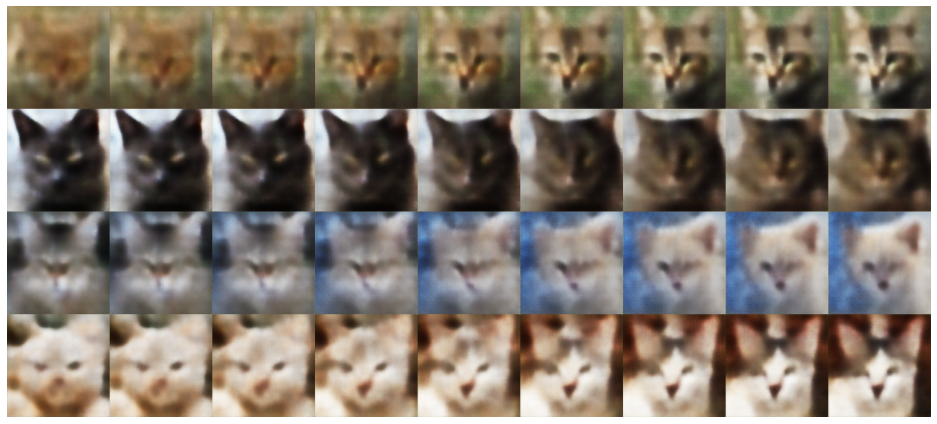

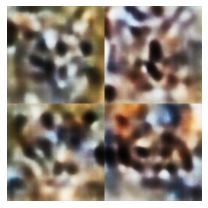

  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 91 | Reconstruction loss: 2425.717388916016 | KLD loss: 1447.1593505859375


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 92 | Reconstruction loss: 2416.0193786621094 | KLD loss: 1449.485629272461


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 93 | Reconstruction loss: 2408.1602172851562 | KLD loss: 1448.5031372070312


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 94 | Reconstruction loss: 2395.4680053710936 | KLD loss: 1446.8312561035157


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 95 | Reconstruction loss: 2382.5664916992187 | KLD loss: 1444.6195159912108


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 96 | Reconstruction loss: 2382.288458251953 | KLD loss: 1443.8698699951171


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 97 | Reconstruction loss: 2365.574847412109 | KLD loss: 1444.0993774414062


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 98 | Reconstruction loss: 2355.2365600585936 | KLD loss: 1444.7962219238282


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 99 | Reconstruction loss: 2349.716436767578 | KLD loss: 1440.811801147461


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 100 | Reconstruction loss: 2339.0053955078124 | KLD loss: 1439.1193756103517


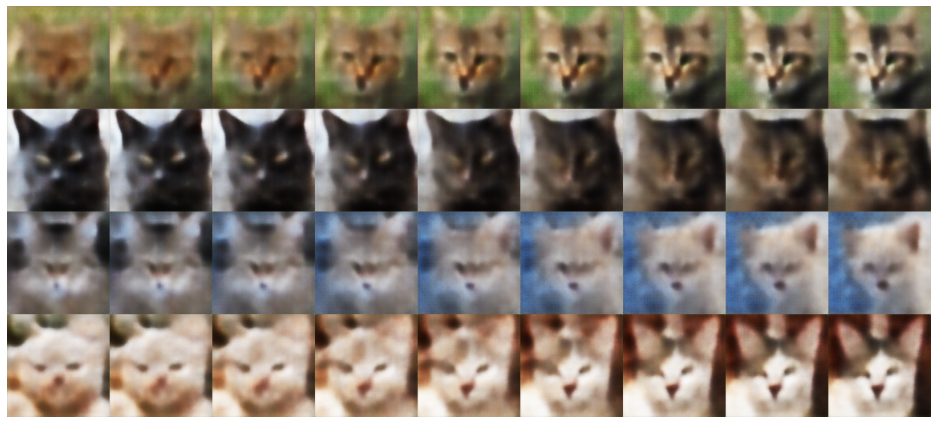

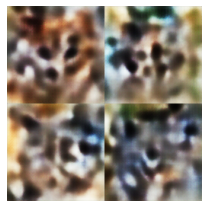

  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 101 | Reconstruction loss: 2322.9787780761717 | KLD loss: 1435.9625762939454


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 102 | Reconstruction loss: 2321.546221923828 | KLD loss: 1437.390591430664


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 103 | Reconstruction loss: 2320.3311157226562 | KLD loss: 1436.8153289794923


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 104 | Reconstruction loss: 2302.9165954589844 | KLD loss: 1437.2836059570313


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 105 | Reconstruction loss: 2292.2722229003907 | KLD loss: 1432.612533569336


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 106 | Reconstruction loss: 2293.492333984375 | KLD loss: 1429.684765625


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 107 | Reconstruction loss: 2287.9382202148436 | KLD loss: 1428.229962158203


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 108 | Reconstruction loss: 2283.8501831054687 | KLD loss: 1428.2481750488282


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 109 | Reconstruction loss: 2270.8857147216795 | KLD loss: 1421.4261108398437


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 110 | Reconstruction loss: 2262.9284606933593 | KLD loss: 1426.1739715576173


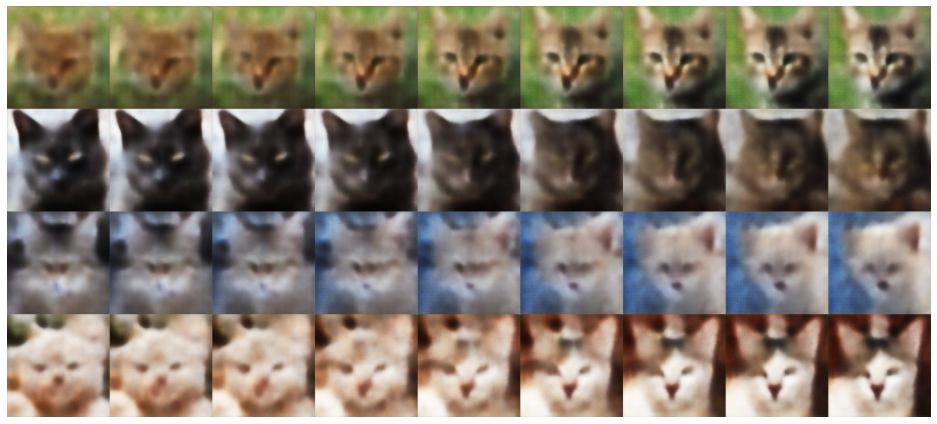

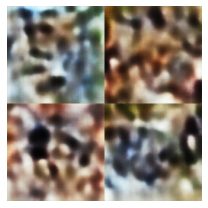

  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 111 | Reconstruction loss: 2254.0162719726563 | KLD loss: 1423.426318359375


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 112 | Reconstruction loss: 2251.2463317871093 | KLD loss: 1422.4772888183593


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 113 | Reconstruction loss: 2244.0042724609375 | KLD loss: 1416.0822631835938


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 114 | Reconstruction loss: 2239.8162384033203 | KLD loss: 1416.7959564208984


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 115 | Reconstruction loss: 2230.2641632080076 | KLD loss: 1414.8318908691406


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 116 | Reconstruction loss: 2224.3725830078124 | KLD loss: 1413.375994873047


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 117 | Reconstruction loss: 2215.405926513672 | KLD loss: 1410.631430053711


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 118 | Reconstruction loss: 2218.740036010742 | KLD loss: 1409.28125


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 119 | Reconstruction loss: 2211.9272399902343 | KLD loss: 1409.8946807861328


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 120 | Reconstruction loss: 2217.538262939453 | KLD loss: 1405.1352813720703


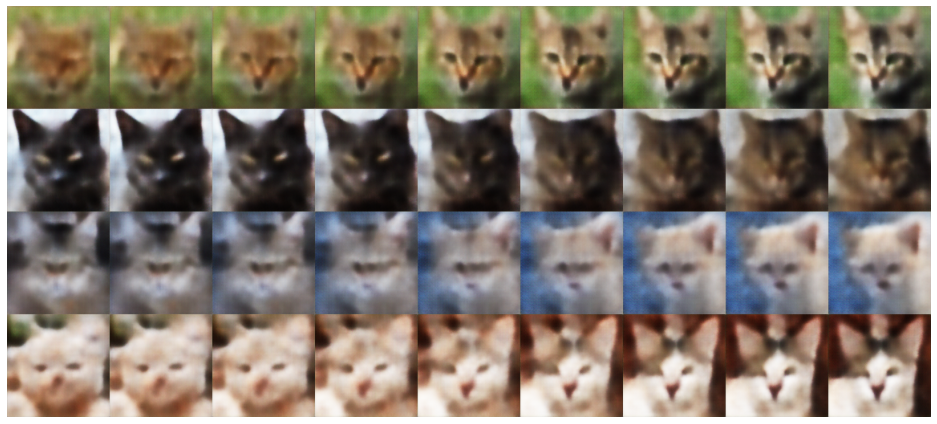

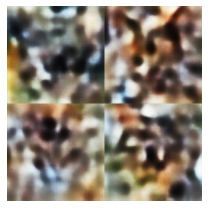

  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 121 | Reconstruction loss: 2195.940533447266 | KLD loss: 1401.307846069336


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 122 | Reconstruction loss: 2186.031072998047 | KLD loss: 1406.7086364746094


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 123 | Reconstruction loss: 2175.3768615722656 | KLD loss: 1402.2382019042968


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 124 | Reconstruction loss: 2176.4450500488283 | KLD loss: 1399.1619903564454


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 125 | Reconstruction loss: 2168.6188690185545 | KLD loss: 1397.7267578125


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 126 | Reconstruction loss: 2162.4159454345704 | KLD loss: 1394.4609619140624


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 127 | Reconstruction loss: 2158.9775573730467 | KLD loss: 1395.4087524414062


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 128 | Reconstruction loss: 2151.6289916992187 | KLD loss: 1390.4150299072267


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 129 | Reconstruction loss: 2148.574499511719 | KLD loss: 1391.431103515625


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 130 | Reconstruction loss: 2146.288949584961 | KLD loss: 1388.1997619628905


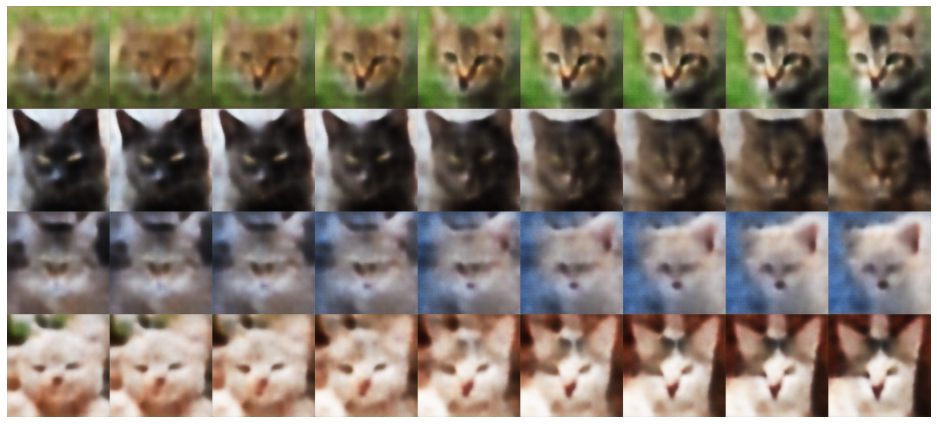

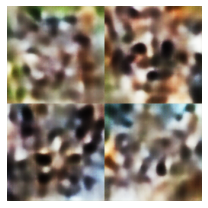

  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 131 | Reconstruction loss: 2134.269436645508 | KLD loss: 1382.982125854492


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 132 | Reconstruction loss: 2144.190148925781 | KLD loss: 1382.320489501953


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 133 | Reconstruction loss: 2131.3016143798827 | KLD loss: 1381.6892700195312


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 134 | Reconstruction loss: 2138.519967651367 | KLD loss: 1379.1098541259767


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 135 | Reconstruction loss: 2128.208346557617 | KLD loss: 1380.7453399658202


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 136 | Reconstruction loss: 2124.4143615722655 | KLD loss: 1370.3778900146485


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 137 | Reconstruction loss: 2111.577297973633 | KLD loss: 1374.5505249023438


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 138 | Reconstruction loss: 2116.213757324219 | KLD loss: 1368.7016967773438


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 139 | Reconstruction loss: 2113.320697021484 | KLD loss: 1370.8712097167968


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 140 | Reconstruction loss: 2104.594171142578 | KLD loss: 1363.0676635742188


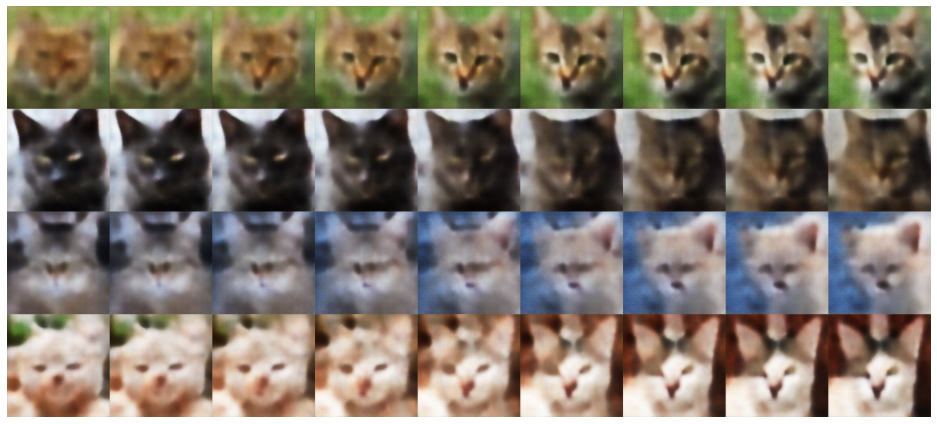

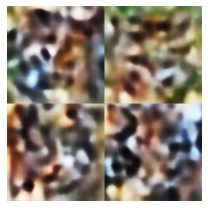

  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 141 | Reconstruction loss: 2100.4488983154297 | KLD loss: 1366.8828033447267


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 142 | Reconstruction loss: 2089.733627319336 | KLD loss: 1360.6695526123046


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 143 | Reconstruction loss: 2080.8481842041015 | KLD loss: 1360.117416381836


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 144 | Reconstruction loss: 2084.3348754882813 | KLD loss: 1358.8209014892577


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 145 | Reconstruction loss: 2097.5838104248046 | KLD loss: 1354.1509887695313


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 146 | Reconstruction loss: 2071.7255615234376 | KLD loss: 1352.462124633789


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 147 | Reconstruction loss: 2059.0488708496096 | KLD loss: 1351.6875793457032


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 148 | Reconstruction loss: 2066.9684997558593 | KLD loss: 1348.0659301757812


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 149 | Reconstruction loss: 2045.5834014892578 | KLD loss: 1346.1679595947267


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 150 | Reconstruction loss: 2047.3844360351563 | KLD loss: 1345.0511505126954


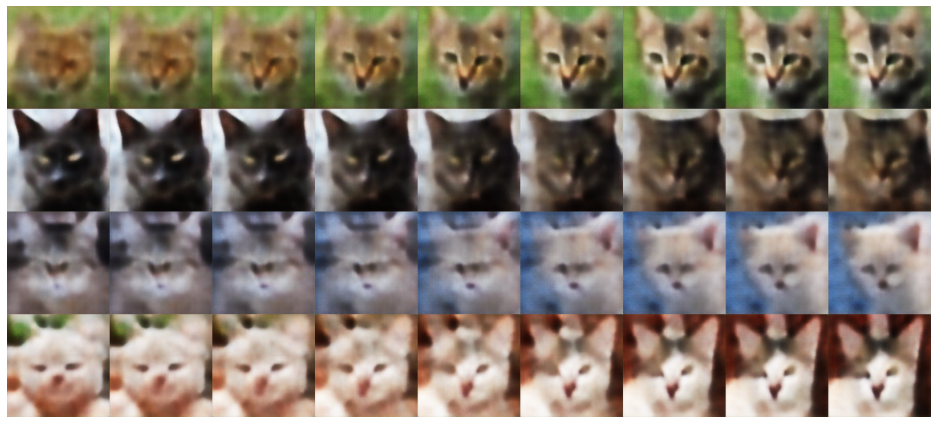

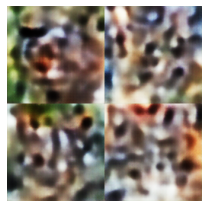

  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 151 | Reconstruction loss: 2052.147869873047 | KLD loss: 1344.2534393310548


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 152 | Reconstruction loss: 2056.878790283203 | KLD loss: 1340.459555053711


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 153 | Reconstruction loss: 2041.7332885742187 | KLD loss: 1340.9157012939454


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 154 | Reconstruction loss: 2033.100274658203 | KLD loss: 1335.165020751953


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 155 | Reconstruction loss: 2035.5819458007813 | KLD loss: 1336.1706512451171


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 156 | Reconstruction loss: 2031.5989624023437 | KLD loss: 1331.8324920654297


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 157 | Reconstruction loss: 2031.2591247558594 | KLD loss: 1330.2629852294922


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 158 | Reconstruction loss: 2030.2676849365234 | KLD loss: 1328.2245880126952


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 159 | Reconstruction loss: 2021.5988677978517 | KLD loss: 1326.300604248047


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 160 | Reconstruction loss: 2012.5667816162108 | KLD loss: 1322.7663513183593


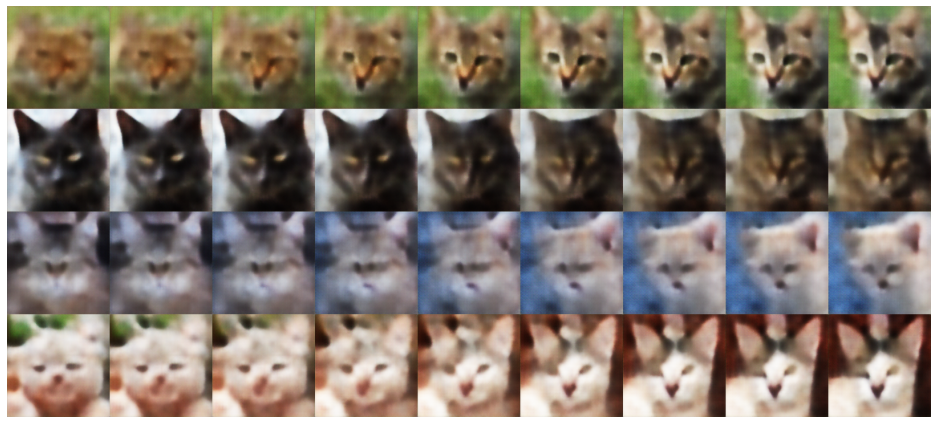

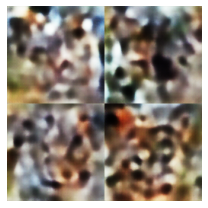

  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 161 | Reconstruction loss: 2008.8420349121093 | KLD loss: 1322.6079711914062


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 162 | Reconstruction loss: 2014.2061920166016 | KLD loss: 1317.0642181396483


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 163 | Reconstruction loss: 2009.5301147460937 | KLD loss: 1314.787026977539


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 164 | Reconstruction loss: 2002.7332977294923 | KLD loss: 1314.0586486816405


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 165 | Reconstruction loss: 1993.948538208008 | KLD loss: 1315.670556640625


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 166 | Reconstruction loss: 1989.058905029297 | KLD loss: 1311.274835205078


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 167 | Reconstruction loss: 1990.5943298339844 | KLD loss: 1308.5201538085937


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 168 | Reconstruction loss: 1988.850830078125 | KLD loss: 1306.0068786621093


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 169 | Reconstruction loss: 1987.203842163086 | KLD loss: 1302.6747009277344


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 170 | Reconstruction loss: 1977.2222595214844 | KLD loss: 1300.5167907714845


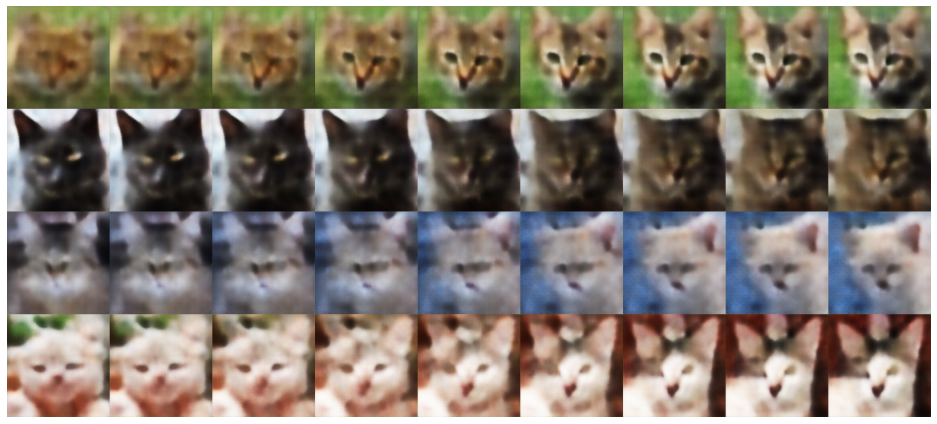

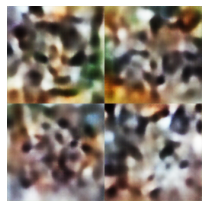

  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 171 | Reconstruction loss: 1988.2241973876953 | KLD loss: 1298.6150177001953


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 172 | Reconstruction loss: 1964.931903076172 | KLD loss: 1295.7010406494142


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 173 | Reconstruction loss: 1960.9085357666015 | KLD loss: 1295.1204223632812


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 174 | Reconstruction loss: 1963.7124145507812 | KLD loss: 1296.6904296875


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 175 | Reconstruction loss: 1958.4622802734375 | KLD loss: 1289.934228515625


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 176 | Reconstruction loss: 1966.9241790771484 | KLD loss: 1288.9337188720704


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 177 | Reconstruction loss: 1962.1877990722655 | KLD loss: 1286.9141357421875


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 178 | Reconstruction loss: 1955.2692413330078 | KLD loss: 1281.635922241211


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 179 | Reconstruction loss: 1949.349298095703 | KLD loss: 1283.3413665771484


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 180 | Reconstruction loss: 1934.3777435302734 | KLD loss: 1279.3248809814454


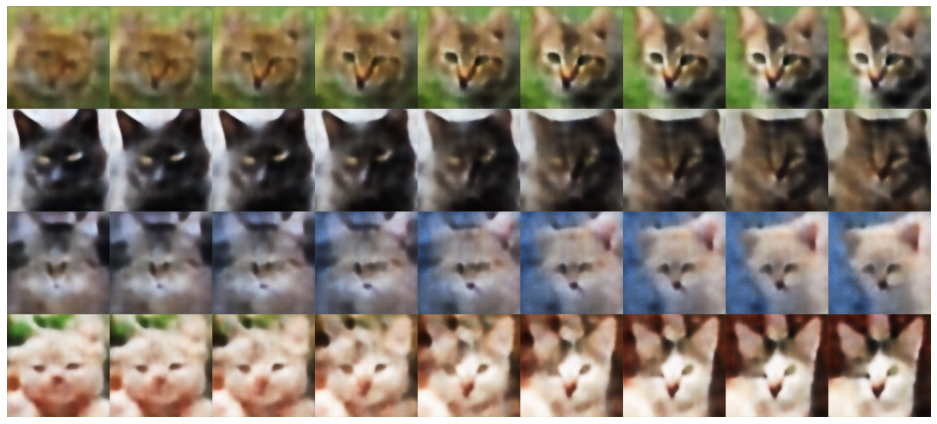

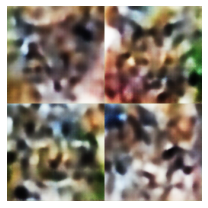

  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 181 | Reconstruction loss: 1940.3915985107421 | KLD loss: 1277.5416748046875


  0%|          | 0/41 [00:00<?, ?it/s]

Epoch 182 | Reconstruction loss: 1929.3083557128907 | KLD loss: 1274.5090240478517


  0%|          | 0/41 [00:00<?, ?it/s]

In [ ]:
train_vae()